In [377]:
from collections import OrderedDict
import itertools
import pandas as pd
import csv

import plotly
import plotly.plotly as py
import plotly.graph_objs as go

import pandas as pd
import math
import json
import pyfpgrowth
from pymining import itemmining

import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np
import matplotlib.pyplot as plt, mpld3
import matplotlib
import matplotlib.cm as cm

import warnings

Read data

In [62]:
features_csv = 'features.csv'
triplets_csv = 'triplets_subset.csv' 

In [63]:
df_triplets = pd.read_csv(triplets_csv) 
df_features = pd.read_csv(features_csv)

In [64]:
print(len(df_triplets))
print(len(df_features))

1003662
382136


In [65]:
#triplets table
userid_t = tuple(df_triplets['user_id']) 
trackid_t = tuple(df_triplets['tps_id'])
playcount_t= tuple(df_triplets['playcounts'])

In [66]:
#frequency table
trackid_f = tuple(df_features['tps_id']) 
genre_f = tuple(df_features['genre'])
album_f = tuple(df_features['album_name'])

In [67]:
df_features.head(n=5)

,tps_id,genre,title,year,album_name,artist_id,artist_name,song_hotttnesss,artist_hotttnesss,duration,loudness,tempo,key,mode,pitchRange,timbreRange
0,SOAADAS12A58A784EC,Pop/Rock,How to Start a Band,2008.0,Radio Free DC Remixed,ARN0L1C1187FB4CD8F,Fort Knox Five featuring Ian Svenonius & Musta...,0.496922,0.406660,225.74975,-7.075,119.951,6.0,1,0.997,597.303
1,SOAAZPG12A6D4F8D8B,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
2,SOABGJE12AB0180B63,Pop/Rock,Planet,0.0,Planet EP,ARXNOOK11F50C49049,Cabbageboy,0.000000,0.342088,341.52444,-7.502,163.822,0.0,1,0.996,482.791
3,SOABMNB12A58A7CEB6,Country,Falta de Sol,0.0,Original Olinda Style,AR0GGKI1187FB391D5,Eddie,0.572920,0.362239,157.09995,-12.675,100.014,7.0,1,0.999,397.597
4,SOABZYG12AB018C5A7,Pop/Rock,The Future,2009.0,Leap Years,ARWSWNS121318C560F,The Little Hands Of Asphalt,0.517417,0.383316,238.15791,-7.351,136.106,5.0,1,0.998,428.704


In [68]:
df_triplets.head(n=5)

,user_id,tps_id,playcounts
0,27c21f013bf67bc60b3cf2b916013fdb076a5dfd,SOAAZPG12A6D4F8D8B,1
1,0ecf68fde722f079e1214491c36dde1930c4aaea,SOAAZPG12A6D4F8D8B,4
2,c1c1bab05044765746d39bc8ffddeafd9d888f22,SOAAZPG12A6D4F8D8B,1
3,9625e9a0db9903eef3e8ef7bb45d56bb99613f82,SOAAZPG12A6D4F8D8B,2
4,8185e166cbe360f6027f2be838cc1317a71e6fdb,SOAAZPG12A6D4F8D8B,1


In [402]:
df = pd.merge(df_triplets, df_features, on="tps_id")

In [403]:
df.head(n=10)

,user_id,tps_id,playcounts,genre,title,year,album_name,artist_id,artist_name,song_hotttnesss,artist_hotttnesss,duration,loudness,tempo,key,mode,pitchRange,timbreRange
0,27c21f013bf67bc60b3cf2b916013fdb076a5dfd,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
1,0ecf68fde722f079e1214491c36dde1930c4aaea,SOAAZPG12A6D4F8D8B,4,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
2,c1c1bab05044765746d39bc8ffddeafd9d888f22,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
3,9625e9a0db9903eef3e8ef7bb45d56bb99613f82,SOAAZPG12A6D4F8D8B,2,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
4,8185e166cbe360f6027f2be838cc1317a71e6fdb,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
5,72f6f9bb41ff068fd80fe62a9c156e8cd21cd4c4,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
6,39c35b215e1483166870dd5d699470d3209b2d40,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
7,5a71e6fe52ddc638045a9f9f86f375976178cfa4,SOAAZPG12A6D4F8D8B,6,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
8,b137005c212da670313148b9259a64d5611cd15d,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494
9,062e8eda43c7b8b624313aaa9b8c16c397946a96,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.52005,345.91302,-7.022,144.301,5.0,1,0.998,429.494


In [409]:
#remove unclassified values
df = df.loc[df['genre']!='unclassified']
print(df.shape)
#remove outliers for artist hotness
df = df.loc[(df['artist_hotttnesss']>0)&(df['artist_hotttnesss']<=1)]
print(df.shape)

(991146, 18)
(986023, 18)


In [410]:
df.head(n=20)

,user_id,tps_id,playcounts,genre,title,year,album_name,artist_id,artist_name,song_hotttnesss,artist_hotttnesss,duration,loudness,tempo,key,mode,pitchRange,timbreRange
0,27c21f013bf67bc60b3cf2b916013fdb076a5dfd,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
1,0ecf68fde722f079e1214491c36dde1930c4aaea,SOAAZPG12A6D4F8D8B,4,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
2,c1c1bab05044765746d39bc8ffddeafd9d888f22,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
3,9625e9a0db9903eef3e8ef7bb45d56bb99613f82,SOAAZPG12A6D4F8D8B,2,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
4,8185e166cbe360f6027f2be838cc1317a71e6fdb,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
5,72f6f9bb41ff068fd80fe62a9c156e8cd21cd4c4,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
6,39c35b215e1483166870dd5d699470d3209b2d40,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
7,5a71e6fe52ddc638045a9f9f86f375976178cfa4,SOAAZPG12A6D4F8D8B,6,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
8,b137005c212da670313148b9259a64d5611cd15d,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494
9,062e8eda43c7b8b624313aaa9b8c16c397946a96,SOAAZPG12A6D4F8D8B,1,Pop/Rock,Everything I Cannot See,2006.0,5:55,ARL635X1187B990092,Charlotte Gainsbourg,0.805456,0.520050,345.91302,-7.022,144.301,5.0,1,0.998,429.494


In [408]:
print(tuple(df['artist_hotttnesss']))

(0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.52004968817897468, 0.36223874670184908, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.5034369536535418, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.57568576023563145, 0.61630825137600731, 0.61630825137600731, 0.61630825137600731, 0.54880794105622432, 0.54880794105622432, 0.54880794105622432, 0.54880794105622432, 0.54880794105622432, 0.54880794105622432, 0.59779347764335478, 0.59779347764335478, 0.59779347764335478, 0.59779347764335478, 0.59779347764335478, 0.59779347764335478, 0.59779347764335478, 0

In [406]:
df.to_csv('refined.csv', sep='\t')

In [411]:
genres_df = tuple(df['genre'])
albums_df = tuple(df['album_name'])

In [412]:
print(len(genres_df))
print(len(albums_df))

986023
986023


In [413]:
print(df_features.shape)
print(df_triplets.shape)
print(df.shape)

(382136, 16)
(1003662, 3)
(986023, 18)


Find most frequent items (and combinations) 

In [200]:
#not needed
def extractgenres(userid):
    genres_user = list(df.loc[df['user_id']==userid,'genre'])
    genres_user = tuple([x for x in genres_user if x != 'unclassified']) #remove unclassified values
    return tuple(tuple([x]) for x in genres_user)   
    

In [358]:
def extractalbums(userid):
    albums_user = list(df.loc[df['user_id']==userid,'album_name'])
    return tuple(tuple([x]) for x in albums_user) 

In [444]:
def avghotness(freq_items_dict, isglobal, userid, attribute):
    #extract top 20
    freqnames = []
    top20items = extracttop20(freq_items_dict)
    for key, value in top20items:
        freqnames.append(key)
    freqnames = listoftuplestolistofstrings(freqnames) 
    avg_hotness_per_category = {}
    for item in freqnames:
        print(item)
        if(attribute == 'genre'):
            if(isglobal):
                hotness = df.loc[df['genre'].str.contains(item),'artist_hotttnesss']
            else:
                hotness = df.loc[df['genre'].str.contains(item)&(df['user_id']==userid),'artist_hotttnesss']
        if(attribute == 'album'):
            if(isglobal):
                hotness = df.loc[(df['album_name']==item),'artist_hotttnesss']
            else:
                hotness = df.loc[(df['album_name']==item) & (df['user_id']==userid) ,'artist_hotttnesss']
                #print(hotness.str.extract([]))
        avg_hotness_per_category[item] = str(round(sum(hotness)/len(hotness),2))
    return avg_hotness_per_category
    

In [387]:
#frequent pattern mining
def frequentpatterns(data,support):
    relim_input = itemmining.get_relim_input(data)
    report = itemmining.relim(relim_input, min_support=support)
    
    #sort the genres based on their frequency (from most frequent to least) 
    sorted_x = OrderedDict(sorted(report.items(), key=lambda x: x[1], reverse=True))   
    sorted_x = dict(sorted_x)
  
    sorted_x = {tuple(k) : v for k, v in sorted_x.items()}
    return sorted_x

In [388]:
def listoftuplestolistofstrings(x):    
    genres = []    
    for genre_combi in x:
        if len(genre_combi) > 1:
            genre_name = ""
            for genre in genre_combi:
                genre_name += str(genre)
                genre_name += ", "
            genre_name = genre_name[:-2]
            genres.append(genre_name)
        else:
            for genre in genre_combi:
                genres.append(str(genre))    
    return genres

In [389]:
def barchart(x,y,title):
    y = normalize(y)  
    y_pos = np.arange(len(x))
    plt.barh(y_pos, y, align='center', alpha=0.2)
    plt.yticks(y_pos, x)
    plt.ylabel('genres')
    plt.xlabel('frequencies')
    plt.title(title)
    plt.show()

In [390]:
def normalize(values):
    #normalize frequencies  
    ny = []
    for i in values:
        i = round(i/sum(values),3)
        ny.append(i)
    return ny

In [391]:
def extracttop20(frequencies):
    genre_freq = itertools.islice(frequencies.items(), 0, 20) 
    return genre_freq

In [392]:
def plot(frequencies_global,frequencies_user):
    genreval = extracttop20(frequencies_global)
    userval = extracttop20(frequencies_user)
    freqgenres, freqvalues, freqsgenres, freqsvalues = [], [] , [], []  
    for key, value in genreval:
        freqgenres.append(key)
        freqvalues.append(value)
    for key,value in userval:
        freqsgenres.append(key)
        freqsvalues.append(value)
    freqgenres = listoftuplestolistofstrings(freqgenres) 
    freqsgenres = listoftuplestolistofstrings(freqsgenres)
    barchart(freqgenres,freqvalues,'global')  
    barchart(freqsgenres,freqsvalues,'user-sprcific')

In [393]:
def scatterplot2(hotnessg,frequencyg,hotnessu,frequ):
    genreval = extracttop20(frequencyg)
    userval = extracttop20(frequ)
    freqgenres, freqvalues, freqsgenres, freqsvalues = [], [] , [], []  
    for key, value in genreval:
        freqgenres.append(key)
        freqvalues.append(value)
    for key,value in userval:
        freqsgenres.append(key)
        freqsvalues.append(value)
    freqgenres = listoftuplestolistofstrings(freqgenres) 
    freqsgenres = listoftuplestolistofstrings(freqsgenres)
    
    fig, ax = plt.subplots(subplot_kw=dict(facecolor='#EEEEEE'))
    #N = 100
    freqg = normalize(freqvalues)
    frequ = normalize(freqsvalues)
    #print(freqg)
    #print(freqgenres)
    
    
    Labels = ["g","u",]
    scatter = ax.scatter(list(hotnessg.values()),freqg, color="orange",marker='o', alpha=0.3)
    ax.plot([], [],"o", color="orange", label="Global")
    scatter2 = ax.scatter(list(hotnessu.values()),frequ, color="blue", marker='o', alpha=0.3)
    ax.plot([], [], "o", color="blue",  label="User-specific")
    #ax.grid(color='white', linestyle='solid')

    ax.set_title("frequency vs artist-hotness", size=20)
    
   
    ax.legend( loc="best", framealpha=0)
    #line_collections = [scatter,scatter2]
    #interactive_legend = mpld3.plugins.InteractiveLegendPlugin(line_collections, Labels)
    #mpld3.plugins.connect(fig, interactive_legend)
    labels = ['{0}'.format(i) for i in freqgenres]
    labeluser = ['{0}'.format(i) for i in freqsgenres]
    tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=labels)
    tooltipu = mpld3.plugins.PointLabelTooltip(scatter2, labels=labeluser)
    mpld3.plugins.connect(fig, tooltip)
    mpld3.plugins.connect(fig,tooltipu)
    
   
    plt.ylabel('frequencies')
    plt.xlabel('hotness')
    #plt.legend(loc=2)
    plt.show()

Global

In [414]:
#convert tuple of strings to tuple of tuples - for freq mining input
formatted_globalgenres = tuple(tuple([x]) for x in genres_df)
formatted_globalalbums = tuple(tuple([x]) for x in albums_df)

In [415]:
print(len(formatted_globalgenres))
print(len(formatted_globalalbums))

986023
986023


In [416]:
genre_frequencies_global = frequentpatterns(formatted_globalgenres,1)

In [417]:
album_frequencies_global = frequentpatterns(formatted_globalalbums,5)

In [418]:
print(album_frequencies_global)

{('Greatest Hits',): 6048, ('My Worlds',): 2505, ('Waking Up',): 2489, ('Save Me_ San Francisco',): 2330, ("Now That's What I Call Music! 75",): 2230, ('Only By The Night',): 2090, ('Lungs',): 2056, ('The Fame Monster',): 2003, ('A Rush Of Blood To The Head',): 1892, ('Fearless',): 1832, ('Vampire Weekend',): 1813, ('Battle Studies',): 1701, ('In Between Dreams',): 1617, ('Vespertine Live',): 1606, ('If There Was A Way',): 1497, ('The Eminem Show',): 1380, ('For Emma_ Forever Ago',): 1337, ('Brothers',): 1333, ('Fallen',): 1283, ('Give Up',): 1269, ('Hybrid Theory',): 1236, ('Cage The Elephant',): 1216, ('Karaoke Monthly Vol. 2 (January 2010)',): 1202, ('The Singles Collection',): 1170, ('Up From Below',): 1169, ('X & Y',): 1155, ('Just Dance',): 1148, ('Ray Guns Are Not Just The Future',): 1134, ('Gold',): 1118, ('Hell Train',): 1118, ('Nova Bis-Cartola',): 1113, ('We Sing.  We Dance.  We Steal Things.',): 1112, ('Use Somebody',): 1089, ('Incredibad',): 1084, ('Brushfire Fairytales',)

In [251]:
print(genre_frequencies_global)

{('Pop/Rock',): 727415, ('Blues',): 76311, ('Rap',): 65211, ('Country',): 40207, ('R&B',): 39852, ('Jazz',): 24924, ('Reggae',): 8153, ('Electronic',): 7587, ('International',): 1405, ('Latin',): 81}


for user 0a45f8336a7c1325fe8faf52d23ed2a6f86c2ce0


In [420]:
userid = '0a45f8336a7c1325fe8faf52d23ed2a6f86c2ce0'

In [421]:
formatted_useralbums = extractalbums(userid)
print(formatted_useralbums)
album_frequencies_user = frequentpatterns(formatted_useralbums,1)

(('Riot!',), ('Trapt',), ('Flyleaf',), ('Flyleaf',), ('Unbreakable',), ('Memento Mori',), ('Someone In Control',), ('All We Know Is Falling',), ('Trapt',), ('Riot!',), ('Made Of Glass Live',), ('Flyleaf',), ('Trapt',), ('Flyleaf',), ('Only Through The Pain',), ('Riot!',), ('All We Know Is Falling',), ('Only Through The Pain',), ('All We Know Is Falling',), ('Trapt',), ('Trapt',), ('Only Through The Pain',), ('Flyleaf',), ('All We Know Is Falling',), ('Trapt',), ('Lost Realist',), ('Only Through The Pain',), ('Only Through The Pain',), ('All We Know Is Falling',), ('Someone In Control',), ('Riot!',), ('Again',), ('Flyleaf',), ('Decode',), ('Riot!',), ('Someone In Control',), ('The Punisher - The Album (Music From The Motion Picture)',), ('Emergency',), ('Memento Mori',), ('Phobia',), ('Halo 2 (Original Soundtrack And New Music) Volume 1',), ('Memento Mori',), ('Memento Mori',), ('Smallville Volume 2 - Metropolis Mix',), ('Unbroken And Unplugged',), ('Someone In Control',), ('All We Know

In [422]:
print(album_frequencies_user)

{('Riot!',): 8, ('Flyleaf',): 7, ('Only Through The Pain',): 7, ('Trapt',): 7, ('All We Know Is Falling',): 6, ('Someone In Control',): 6, ('Memento Mori',): 4, ('brand new eyes',): 2, ('Again',): 1, ('Decode',): 1, ('Emergency',): 1, ('Guitar Hero III Legends of Rock Companion Pack',): 1, ('Halo 2 (Original Soundtrack And New Music) Volume 1',): 1, ("I'm So Sick",): 1, ('Ignorance',): 1, ('Lost Realist',): 1, ('Made Of Glass Live',): 1, ('Phobia',): 1, ('Smallville Volume 2 - Metropolis Mix',): 1, ("That's What You Get",): 1, ('The Healing Of Harms',): 1, ('The Only Exception',): 1, ('The Punisher - The Album (Music From The Motion Picture)',): 1, ('Unbreakable',): 1, ('Unbroken And Unplugged',): 1}


In [423]:
formatted_usergenres = extractgenres(userid)
print(formatted_usergenres)
genre_frequencies_user = frequentpatterns(formatted_usergenres,1)

(('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Blues',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',), ('R&B',), ('Pop/Rock',), ('Reggae',), ('Pop/Rock',), ('Pop/Rock',), ('Pop/Rock',))


In [424]:
print(genre_frequencies_user)

{('Pop/Rock',): 61, ('Blues',): 1, ('R&B',): 1, ('Reggae',): 1}


In [425]:
for key,value in genre_frequencies_global.items():
    print(key)
    print(value)

('Pop/Rock',)
724575
('Blues',)
75323
('Rap',)
64805
('Country',)
39957
('R&B',)
39633
('Jazz',)
24606
('Reggae',)
8134
('Electronic',)
7542
('International',)
1367
('Latin',)
81


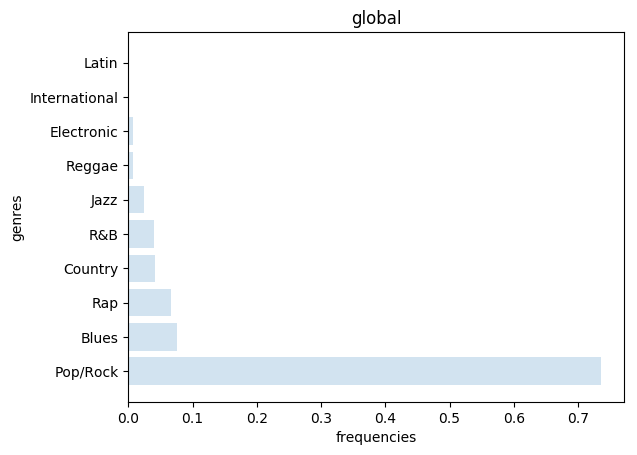

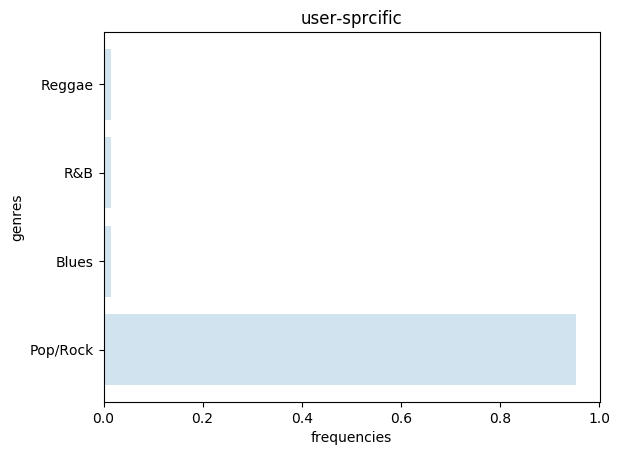

In [427]:
plot(dict(genre_frequencies_global),dict(genre_frequencies_user))

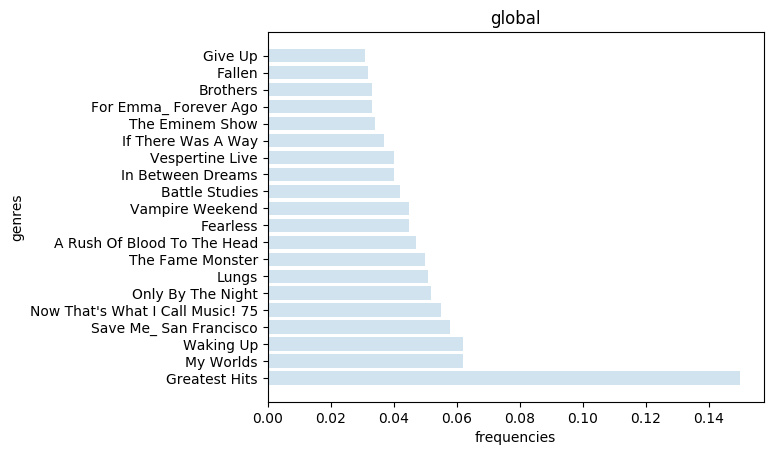

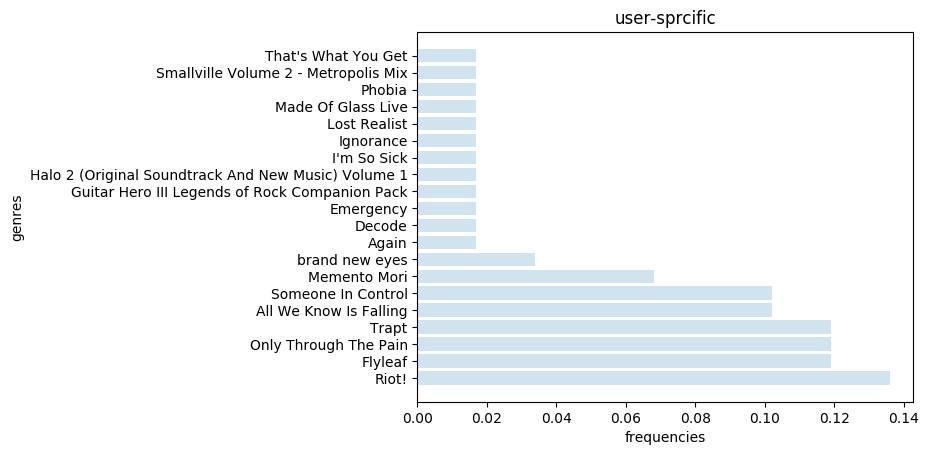

In [428]:
plot(dict(album_frequencies_global),dict(album_frequencies_user))

In [429]:
#extract avg artist hotness per genre
avg_hotness_global = avghotness(dict(genre_frequencies_global), True, '0', 'genre')
avg_hotness_user = avghotness(dict(genre_frequencies_user), False,userid,'genre')


Pop/Rock
Blues
Rap
Country
R&B
Jazz
Reggae
Electronic
International
Latin
Pop/Rock
Blues
R&B
Reggae


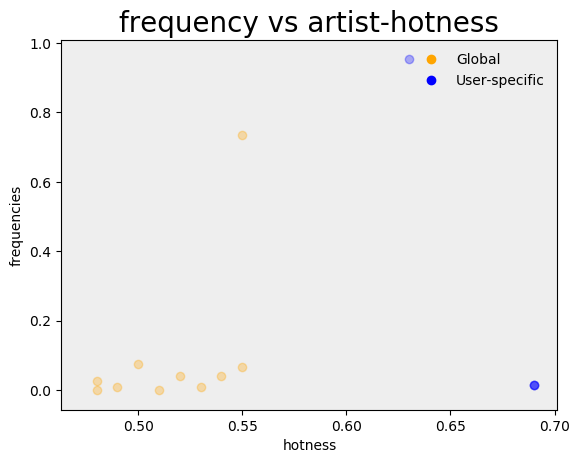

In [430]:
scatterplot2(avg_hotness_global,genre_frequencies_global,avg_hotness_user,genre_frequencies_user)

In [445]:
#extract avg artist hotness per album
avg_hotness_global = avghotness(dict(album_frequencies_global), True, '0', 'album')
avg_hotness_user = avghotness(dict(album_frequencies_user), False,userid,'album')
print(avg_hotness_global)
print(avg_hotness_user)

Greatest Hits
My Worlds
Waking Up
Save Me_ San Francisco
Now That's What I Call Music! 75
Only By The Night
Lungs
The Fame Monster
A Rush Of Blood To The Head
Fearless
Vampire Weekend
Battle Studies
In Between Dreams
Vespertine Live
If There Was A Way
The Eminem Show
For Emma_ Forever Ago
Brothers
Fallen
Give Up
Riot!
Flyleaf
Only Through The Pain
Trapt
All We Know Is Falling
Someone In Control
Memento Mori
brand new eyes
Again
Decode
Emergency
Guitar Hero III Legends of Rock Companion Pack
Halo 2 (Original Soundtrack And New Music) Volume 1
I'm So Sick
Ignorance
Lost Realist
Made Of Glass Live
Phobia
Smallville Volume 2 - Metropolis Mix
That's What You Get
{'Greatest Hits': '0.58', 'My Worlds': '0.69', 'Waking Up': '0.79', 'Save Me_ San Francisco': '0.78', "Now That's What I Call Music! 75": '0.72', 'Only By The Night': '0.8', 'Lungs': '0.76', 'The Fame Monster': '0.84', 'A Rush Of Blood To The Head': '0.92', 'Fearless': '0.9', 'Vampire Weekend': '0.71', 'Battle Studies': '0.74', 'In 

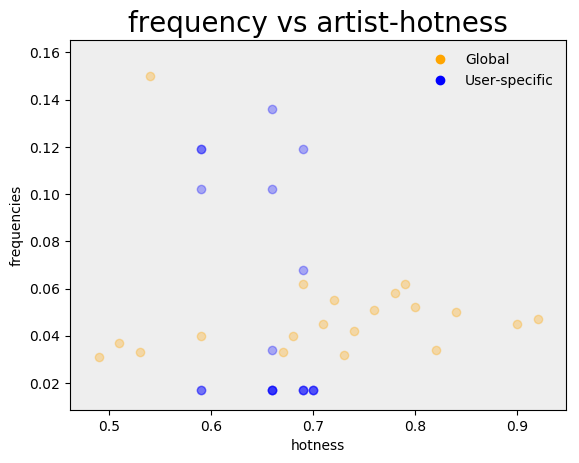

In [442]:
scatterplot2(avg_hotness_global,album_frequencies_global,avg_hotness_user,album_frequencies_user)

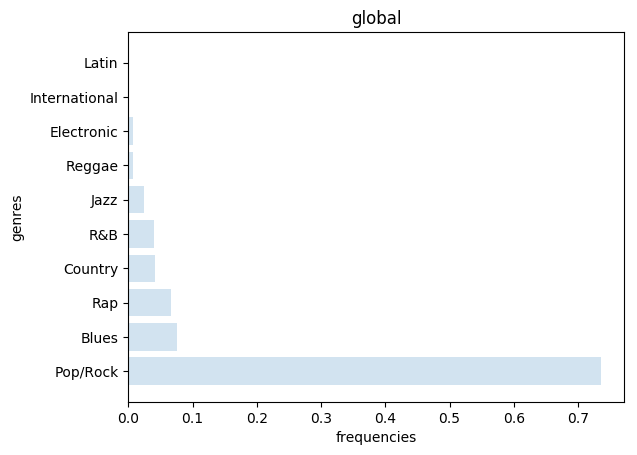

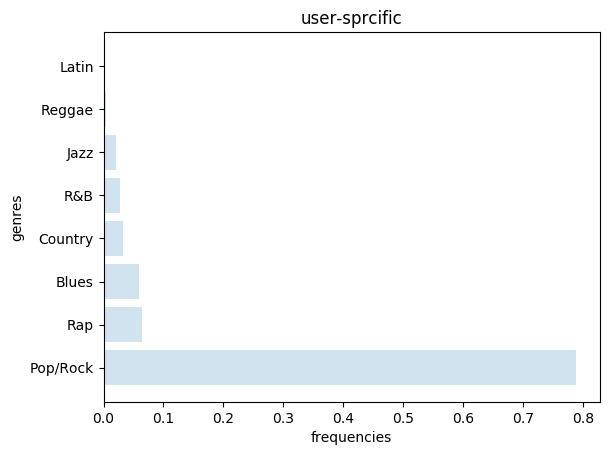

In [446]:
userid = 'f49289b47dc92c896fda09f175fabfed3822b791'
formatted_usergenres = extractgenres(userid)
#print(formatted_usergenres)
genre_frequencies_user = frequentpatterns(formatted_usergenres,1)
#print(genre_frequencies_user)
plot(dict(genre_frequencies_global),dict(genre_frequencies_user))

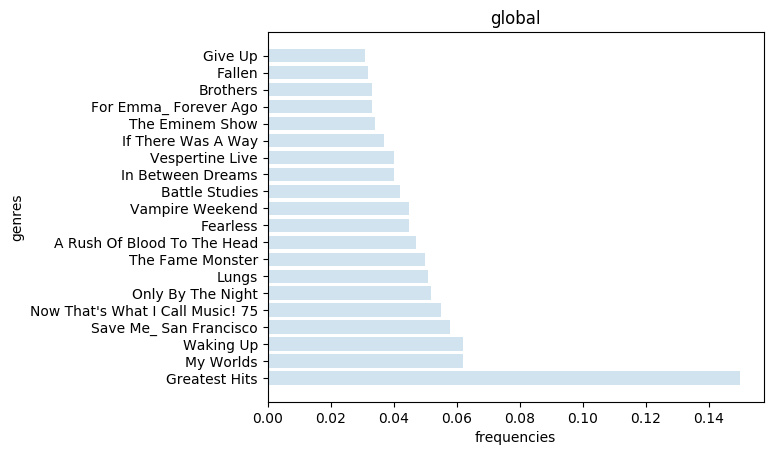

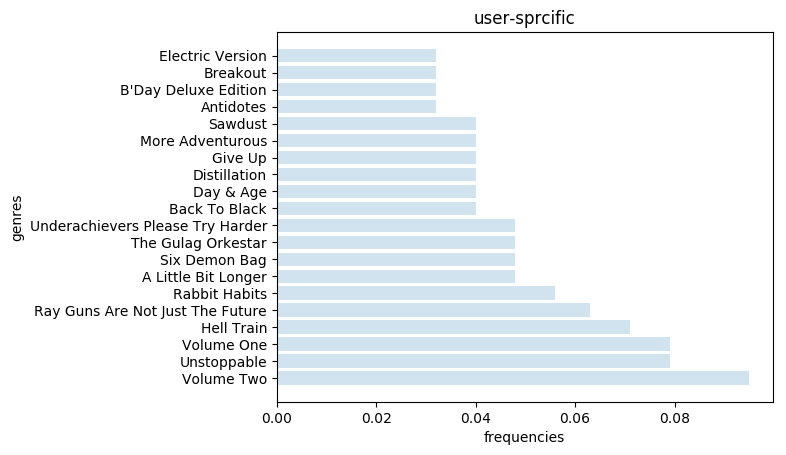

In [447]:
formatted_useralbums = extractalbums(userid)
#print(formatted_useralbums)
album_frequencies_user = frequentpatterns(formatted_useralbums,1)
plot(dict(album_frequencies_global),dict(album_frequencies_user))

Pop/Rock
Blues
Rap
Country
R&B
Jazz
Reggae
Electronic
International
Latin
Pop/Rock
Rap
Blues
Country
R&B
Jazz
Reggae
Latin


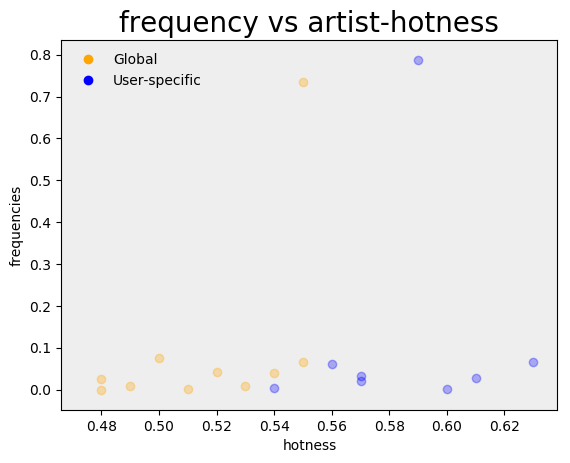

In [448]:
#extract avg artist hotness per genre
avg_hotness_global = avghotness(dict(genre_frequencies_global), True, '0', 'genre')
avg_hotness_user = avghotness(dict(genre_frequencies_user), False,userid,'genre')
scatterplot2(avg_hotness_global,genre_frequencies_global,avg_hotness_user,genre_frequencies_user)

Greatest Hits
My Worlds
Waking Up
Save Me_ San Francisco
Now That's What I Call Music! 75
Only By The Night
Lungs
The Fame Monster
A Rush Of Blood To The Head
Fearless
Vampire Weekend
Battle Studies
In Between Dreams
Vespertine Live
If There Was A Way
The Eminem Show
For Emma_ Forever Ago
Brothers
Fallen
Give Up
Volume Two
Unstoppable
Volume One
Hell Train
Ray Guns Are Not Just The Future
Rabbit Habits
A Little Bit Longer
Six Demon Bag
The Gulag Orkestar
Underachievers Please Try Harder
Back To Black
Day & Age
Distillation
Give Up
More Adventurous
Sawdust
Antidotes
B'Day Deluxe Edition
Breakout
Electric Version


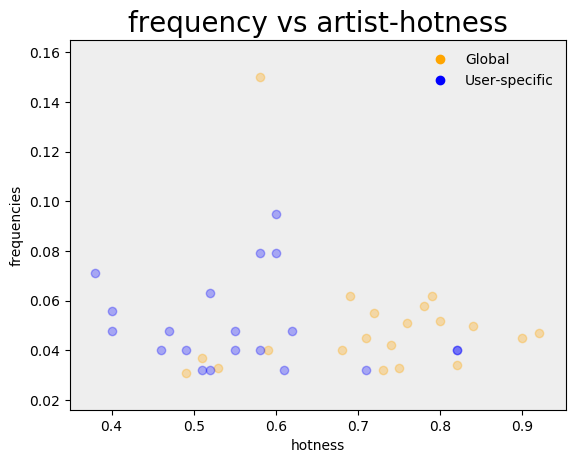

In [449]:
#extract avg artist hotness per album
avg_hotness_global = avghotness(dict(album_frequencies_global), True, '0', 'album')
avg_hotness_user = avghotness(dict(album_frequencies_user), False,userid,'album')
scatterplot2(avg_hotness_global,album_frequencies_global,avg_hotness_user,album_frequencies_user)

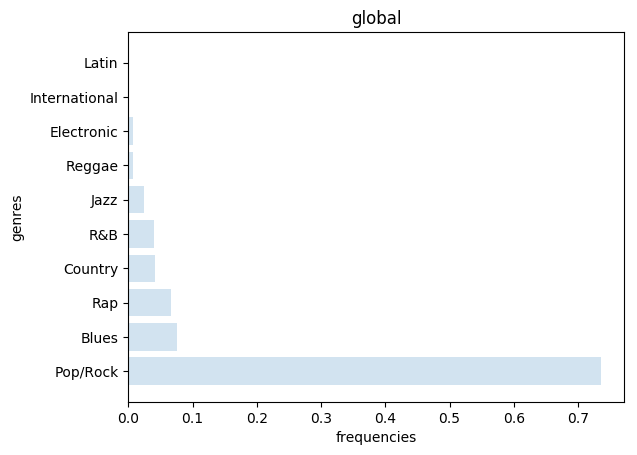

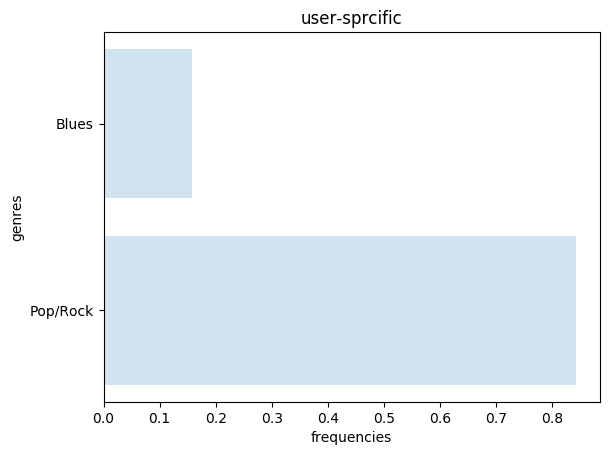

In [450]:
userid = '0ae7a1d8fe5f062acfc331095464da32a1b125c2'
formatted_usergenres = extractgenres(userid)
#print(formatted_usergenres)
genre_frequencies_user = frequentpatterns(formatted_usergenres,1)
#print(genre_frequencies_user)
plot(dict(genre_frequencies_global),dict(genre_frequencies_user))

Frequency of albums vs. artist hotness for the album  

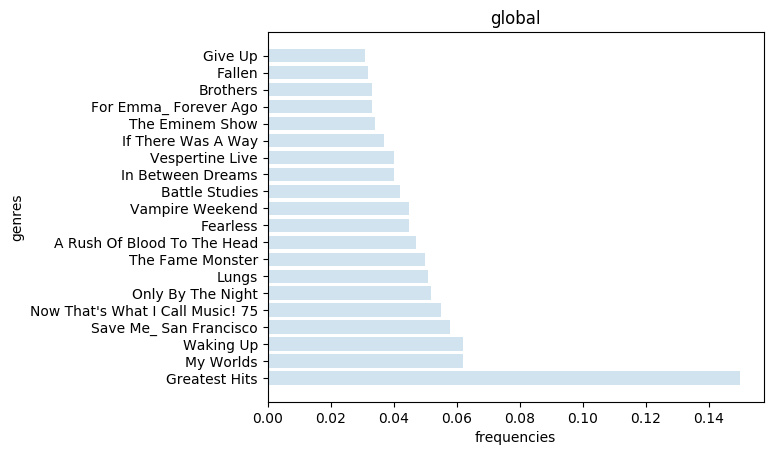

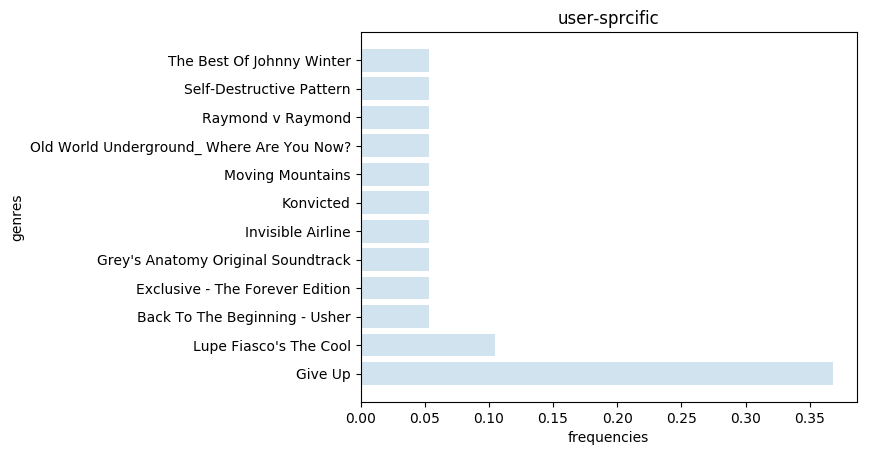

In [451]:
formatted_useralbums = extractalbums(userid)
#print(formatted_useralbums)
album_frequencies_user = frequentpatterns(formatted_useralbums,1)
plot(dict(album_frequencies_global),dict(album_frequencies_user))

## scatterplot

Genre-wise

In [452]:
#extract avg artist hotness per genre
avg_hotness_global = avghotness(dict(genre_frequencies_global), True, '0', 'genre')
avg_hotness_user = avghotness(dict(genre_frequencies_user), False,userid,'genre')
print(avg_hotness_global)
print(avg_hotness_user)

Pop/Rock
Blues
Rap
Country
R&B
Jazz
Reggae
Electronic
International
Latin
Pop/Rock
Blues
{'Pop/Rock': '0.55', 'Blues': '0.5', 'Rap': '0.55', 'Country': '0.52', 'R&B': '0.54', 'Jazz': '0.48', 'Reggae': '0.53', 'Electronic': '0.49', 'International': '0.51', 'Latin': '0.48'}
{'Pop/Rock': '0.62', 'Blues': '0.44'}


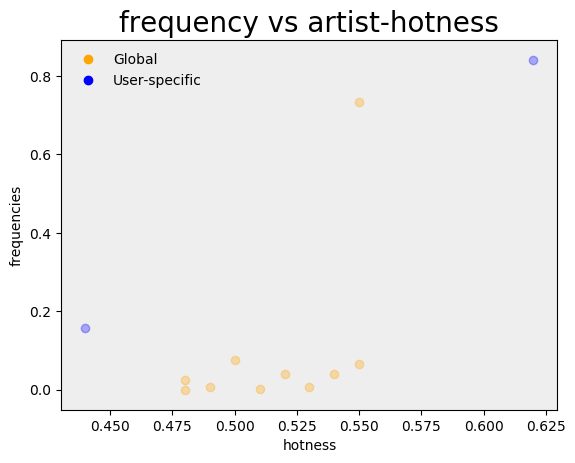

In [453]:
scatterplot2(avg_hotness_global,genre_frequencies_global,avg_hotness_user,genre_frequencies_user)


In [454]:
#extract avg artist hotness per album
avg_hotness_global = avghotness(dict(album_frequencies_global), True, '0', 'album')
avg_hotness_user = avghotness(dict(album_frequencies_user), False,userid,'album')
print(avg_hotness_global)
print(avg_hotness_user)

Greatest Hits
My Worlds
Waking Up
Save Me_ San Francisco
Now That's What I Call Music! 75
Only By The Night
Lungs
The Fame Monster
A Rush Of Blood To The Head
Fearless
Vampire Weekend
Battle Studies
In Between Dreams
Vespertine Live
If There Was A Way
The Eminem Show
For Emma_ Forever Ago
Brothers
Fallen
Give Up
Give Up
Lupe Fiasco's The Cool
Back To The Beginning - Usher
Exclusive - The Forever Edition
Grey's Anatomy Original Soundtrack
Invisible Airline
Konvicted
Moving Mountains
Old World Underground_ Where Are You Now?
Raymond v Raymond
Self-Destructive Pattern
The Best Of Johnny Winter
{'Greatest Hits': '0.58', 'My Worlds': '0.69', 'Waking Up': '0.79', 'Save Me_ San Francisco': '0.78', "Now That's What I Call Music! 75": '0.72', 'Only By The Night': '0.8', 'Lungs': '0.76', 'The Fame Monster': '0.84', 'A Rush Of Blood To The Head': '0.92', 'Fearless': '0.9', 'Vampire Weekend': '0.71', 'Battle Studies': '0.74', 'In Between Dreams': '0.68', 'Vespertine Live': '0.59', 'If There Was A 

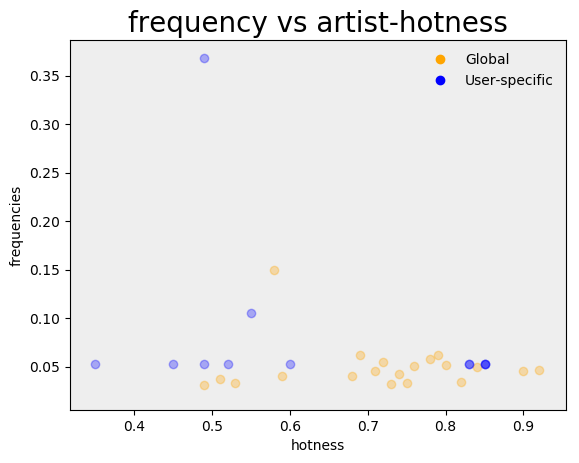

In [455]:
scatterplot2(avg_hotness_global,album_frequencies_global,avg_hotness_user,album_frequencies_user)